<a href="https://colab.research.google.com/github/emmad225/BIACoursework/blob/main/duffyep_lab10_image_segmentation_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# [CSCI 3397/PSYC 3317] Lab 10: Image Segmentation and Generation

**Posted:** Friday, April 19, 2024

**Due:** Friday, April 26, 2024

__Total Points__: 9 pts

# <b>1. Image segmentation</b>

## 1.1. FCN: Fully convolutional network

**Acknowledgement**: `
Satya Mallick: https://github.com/spmallick/learnopencv`

### (a) Data

 #### Download and visualization

2024-04-30 20:06:35 URL:http://learnopencv.com/wp-content/uploads/2021/01/person-segmentation.jpeg [95431/95431] -> "person.png" [1]


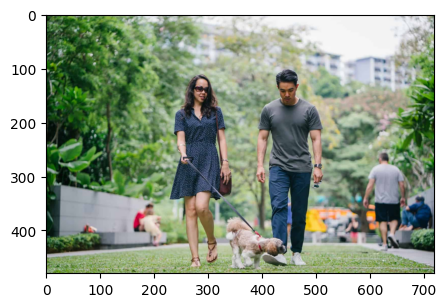

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

!wget -nv "https://www.learnopencv.com/wp-content/uploads/2021/01/person-segmentation.jpeg" -O person.png
img = Image.open('./person.png')
height=480
img = img.resize((int(float(img.size[0])*height/float(img.size[1])),height))

plt.rcParams["figure.figsize"] = (5,5)
plt.imshow(img); plt.show()

#### Pre-process

- Convert it to Tensor - all the values in the image becomes between `[0, 1]` from `[0, 255]`
- Normalize it with the Imagenet specific values `mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225]`

And lastly, we unsqueeze the image so that it becomes `[1 x C x H x W]` from `[C x H x W]` <br/>
We need a batch dimension while passing it to the models.

In [ ]:
# Apply the transformations needed
import torchvision.transforms as T
trf = T.Compose([T.ToTensor(),
                 T.Normalize(mean = [0.485, 0.456, 0.406],
                             std = [0.229, 0.224, 0.225])])
img_pt = trf(img).unsqueeze(0)

### (b) Model examination


In [ ]:
import torch
from torchvision import models
fcn = models.segmentation.fcn_resnet50(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FCN_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=FCN_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fcn_resnet50_coco-1167a1af.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet50_coco-1167a1af.pth
100%|██████████| 135M/135M [00:01<00:00, 78.8MB/s]


In [ ]:
fcn.modules

<bound method Module.modules of FCN(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (1): Bottleneck(
        (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
      )
      (2): Bottleneck(
        (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
      )
    )
    (layer2): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(256, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(256, 512, kernel_size=(1, 1), stride=(2, 2), bias=False)
          (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (1): Bottleneck(
        (conv1): Conv2d(512, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
      )
      (2): Bottleneck(
        (conv1): Conv2d(512, 128, kernel_size=(1, 1), stri

### (c) Inference

In [ ]:
# turn on the evaluation mode
fcn.eval()

# only the deep learning part
with torch.no_grad():
  backbone_output = fcn.backbone(img_pt)
print('Network output shape:', backbone_output['out'].shape)

Network output shape: torch.Size([1, 2048, 60, 90])


In [ ]:
# the base model forward() has interpolation
# https://github.com/pytorch/vision/blob/9ae833af31a20e3a5113bfca30dc34ac708000d8/torchvision/models/segmentation/_utils.py#L27
with torch.no_grad():
  out = fcn(img_pt)['out']
print('Final output shape:', out.shape)

Final output shape: torch.Size([1, 21, 480, 719])


#### Visualization
The model was trained on `21` classes and thus our output have `21` channels!
We take a max index for each pixel position, which represents the class

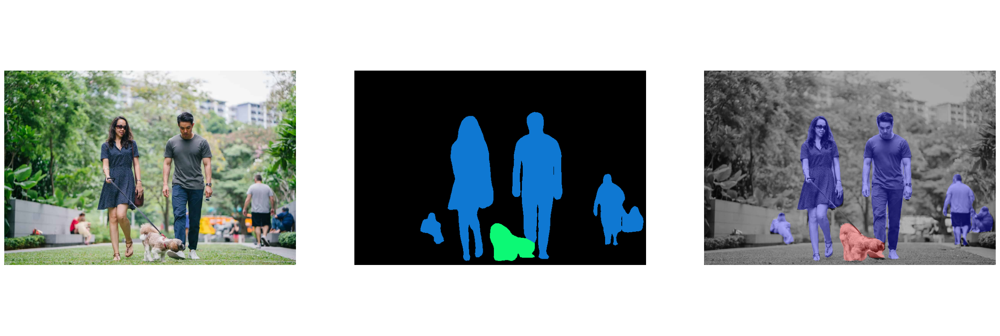

In [ ]:
out_pred = out[0].argmax(0)

# create a color pallette, selecting a color for each class
palette = torch.tensor([2 ** 25 - 1, 2 ** 15 - 1, 2 ** 21 - 1])
colors = torch.as_tensor([i for i in range(21)])[:, None] * palette
colors = (colors % 255).numpy().astype("uint8")

# plot the semantic segmentation predictions of 21 classes in each color
r = Image.fromarray(out_pred.byte().cpu().numpy()).resize(img.size)
r.putpalette(colors)

import matplotlib.pyplot as plt
from skimage.color import label2rgb
import numpy as np

plt.rcParams["figure.figsize"] = (30,10)
plt.subplot(131)
plt.imshow(img);plt.axis('equal');plt.axis('off')
plt.subplot(132)
plt.imshow(r);plt.axis('equal');plt.axis('off')
plt.subplot(133)
plt.imshow(label2rgb(out_pred.cpu().numpy(), image=np.array(img)));plt.axis('equal');plt.axis('off')

plt.show()

## 1.2 U-Net

Follow the code example for FCN and complete the following exercise.

### (a) Data

 #### Download and visualization

--2024-04-30 20:07:21--  https://github.com/mateuszbuda/brain-segmentation-pytorch/raw/master/assets/TCGA_CS_4944.png
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/mateuszbuda/brain-segmentation-pytorch/master/assets/TCGA_CS_4944.png [following]
--2024-04-30 20:07:21--  https://raw.githubusercontent.com/mateuszbuda/brain-segmentation-pytorch/master/assets/TCGA_CS_4944.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 76940 (75K) [image/png]
Saving to: ‘brain.png’

brain.png           100%[===================>]  75.14K  --.-KB/s    in 0.01s   

2024-04-30 20:07:22 (5.79 MB/s) - ‘brain.png’ sa

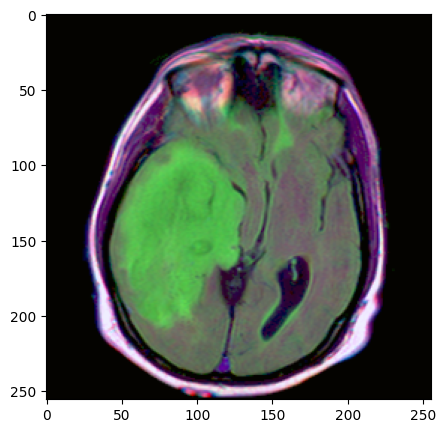

In [ ]:
# Download a brain image
! wget https://github.com/mateuszbuda/brain-segmentation-pytorch/raw/master/assets/TCGA_CS_4944.png -O  brain.png

from PIL import Image
img = Image.open('brain.png')

plt.rcParams["figure.figsize"] = (5,5)
plt.imshow(img); plt.show()

#### Pre-process [3 pts]

In [ ]:
import numpy as np
from torchvision import transforms

# convert the image range to 0-1
img_arr = np.array(img)/255.

# compute channel-wise mean and std
# need to feed it to: transforms.Normalize
normalization_mean = np.mean(img_arr, axis=(0, 1))
normalization_std = np.std(img_arr, axis=(0, 1))

preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(normalization_mean, normalization_std)
])

# pre-process the image and make it 4-dimensional
input_batch = preprocess(img).unsqueeze(0)

### (b) Model examination [2 pts]

Write down the names of the top-level modules. Hints: it's an encoder-decoder architecture.

In [ ]:
import torch
unet = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, pretrained=True)

/usr/local/lib/python3.10/dist-packages/torch/hub.py:294: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/releases/download/v1.0/unet-e012d006.pt" to /root/.cache/torch/hub/checkpoints/unet-e012d006.pt


In [ ]:
#recieved help here
top_level_modules = [name for name, module in unet.named_children()]
for module_name in top_level_modules:
    print(module_name)

encoder1
pool1
encoder2
pool2
encoder3
pool3
encoder4
pool4
bottleneck
upconv4
decoder4
upconv3
decoder3
upconv2
decoder2
upconv1
decoder1
conv


### (c) Inference [2 pts]

Hint: look at (3) in section 1.1


In [ ]:
with torch.no_grad():
 output = unet(input_batch)

####  Visualization [2 pts]

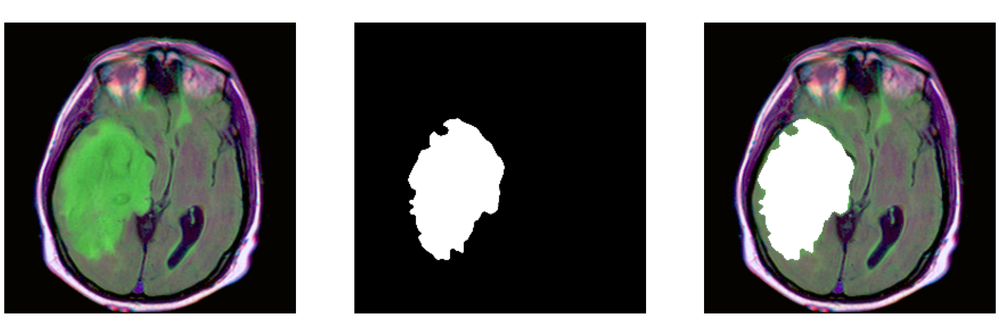

In [ ]:
plt.rcParams["figure.figsize"] = (30,10)

# image
plt.subplot(131)
plt.imshow(img);
plt.axis('equal');plt.axis('off')

# binary segmentation. just display the seg and okay not to use the palette
plt.subplot(132)
#### Your code starts here
binary_segmentation = output.squeeze().numpy()
plt.imshow(binary_segmentation, cmap='gray')
#### Your code ends here
plt.axis('equal');plt.axis('off')

# overlay segmentation onto the image
plt.subplot(133)
overlay_segmentation = img.copy()
overlay_segmentation.paste((255, 255, 255), box=None, mask=Image.fromarray((binary_segmentation > 0.5).astype(np.uint8) * 255))
plt.imshow(overlay_segmentation)
plt.axis('equal');plt.axis('off')
plt.show()


# <b>2. Image generation</b>


## 2.1 GAN (DCGAN)

**Acknowledgement**: `Nathan Inkawhich <https://github.com/inkawhich>`

In [ ]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


### (a) Data

#### Download and pre-process

In [ ]:
! wget --no-check-certificate https://cseweb.ucsd.edu/~weijian/static/datasets/celeba/img_align_celeba.zip -O img_align_celeba.zip

--2024-04-30 20:07:47--  https://cseweb.ucsd.edu/~weijian/static/datasets/celeba/img_align_celeba.zip
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 1443490838 (1.3G) [application/zip]
Saving to: ‘img_align_celeba.zip’

img_align_celeba.zi 100%[===================>]   1.34G  58.3MB/s    in 24s     

2024-04-30 20:08:19 (56.9 MB/s) - ‘img_align_celeba.zip’ saved [1443490838/1443490838]



In [ ]:
import os
import zipfile
import gdown
import torch
from natsort import natsorted
from PIL import Image
from torch.utils.data import Dataset
from torchvision import transforms

## Setup
# Number of gpus available
ngpu = 1
device = torch.device('cuda:0' if (
    torch.cuda.is_available() and ngpu > 0) else 'cpu')

## Fetch data from Google Drive
# Root directory for the dataset
data_root = './'
# Path to folder with the dataset
dataset_folder = f'{data_root}/img_align_celeba'
# URL for the CelebA dataset
#url = 'https://drive.google.com/file/d/1qzaAz5CBvc9yUo1oLcauuY5tya1SArt2/'
# Path to download the dataset to
download_path = f'{data_root}/img_align_celeba.zip'

# Create required directories
if not os.path.exists(data_root):
  os.makedirs(data_root)
  os.makedirs(dataset_folder)

# Download the dataset from google drive
# gdown.download(url, download_path, quiet=False)

# Unzip the downloaded file
with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(dataset_folder)

## Create a custom Dataset class
class CelebADataset(Dataset):
  def __init__(self, root_dir, transform=None):
    """
    Args:
      root_dir (string): Directory with all the images
      transform (callable, optional): transform to be applied to each image sample
    """
    # Read names of images in the root directory
    image_names = os.listdir(root_dir)

    self.root_dir = root_dir
    self.transform = transform
    self.image_names = natsorted(image_names)

  def __len__(self):
    return len(self.image_names)

  def __getitem__(self, idx):
    # Get the path to the image
    img_path = os.path.join(self.root_dir, self.image_names[idx])
    # Load image and convert it to RGB
    img = Image.open(img_path).convert('RGB')
    # Apply transformations to the image
    if self.transform:
      img = self.transform(img)

    return img

## Load the dataset
# Path to directory with all the images
img_folder = f'{dataset_folder}/img_align_celeba'
# Spatial size of training images, images are resized to this size.
image_size = 64
# Transformations to be applied to each individual image sample
transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5],
                          std=[0.5, 0.5, 0.5])
])
# Load the dataset from file and apply transformations
celeba_dataset = CelebADataset(img_folder, transform)

## Create a dataloader
# Batch size during training
batch_size = 128
# Number of workers for the dataloader
num_workers = 0 if device.type == 'cuda' else 1
# Whether to put fetched data tensors to pinned memory
pin_memory = True if device.type == 'cuda' else False

celeba_dataloader = torch.utils.data.DataLoader(celeba_dataset,
                                                batch_size=batch_size,
                                                num_workers=num_workers,
                                                pin_memory=pin_memory,
                                                shuffle=True)

#### Visualization

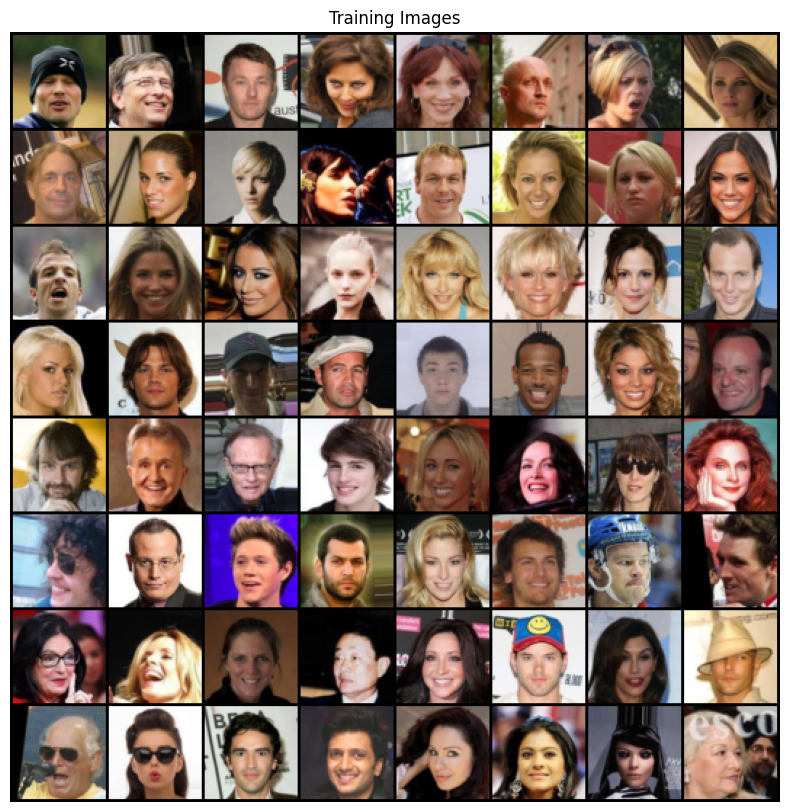

In [ ]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(celeba_dataloader))
plt.figure(figsize=(10,10))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

### (b) Model



#### Model definition

In [ ]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)



In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

#### Model Initialization

In [ ]:
# Batch size during training
batch_size = 128
# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64
# Number of training epochs
num_epochs = 5
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5
# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)
netD = Discriminator(ngpu).to(device)

### (c) Loss function

In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0


### (d) Optimization

In [ ]:
# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

### (e) Start Training

Starting Training Loop...
[0/5][0/1583]	Loss_D: 1.4034	Loss_G: 2.7750	D(x): 0.5138	D(G(z)): 0.5099 / 0.0659


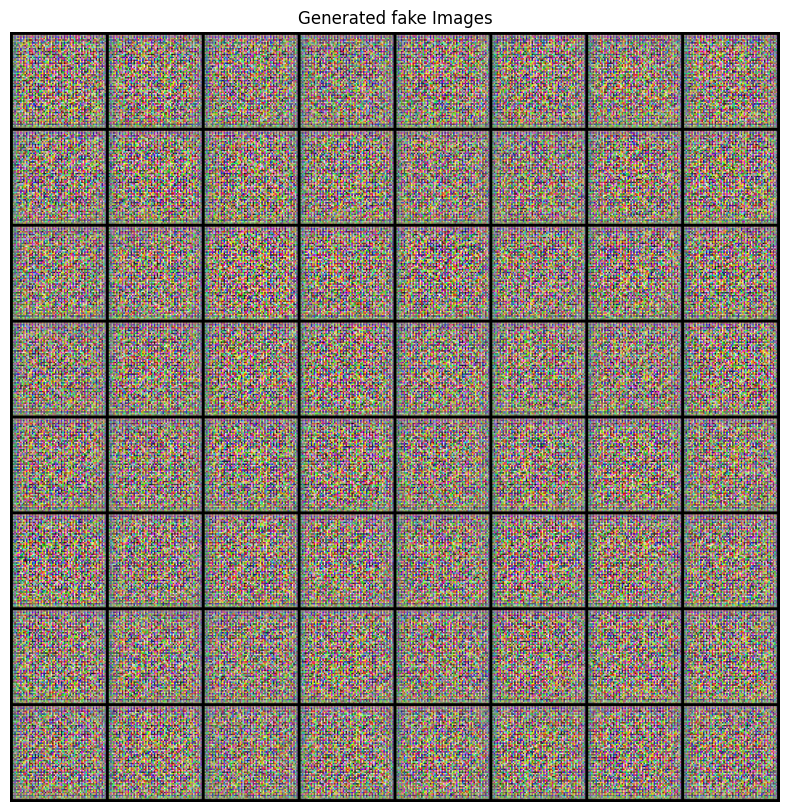

[0/5][50/1583]	Loss_D: 0.2149	Loss_G: 14.3407	D(x): 0.8673	D(G(z)): 0.0000 / 0.0000


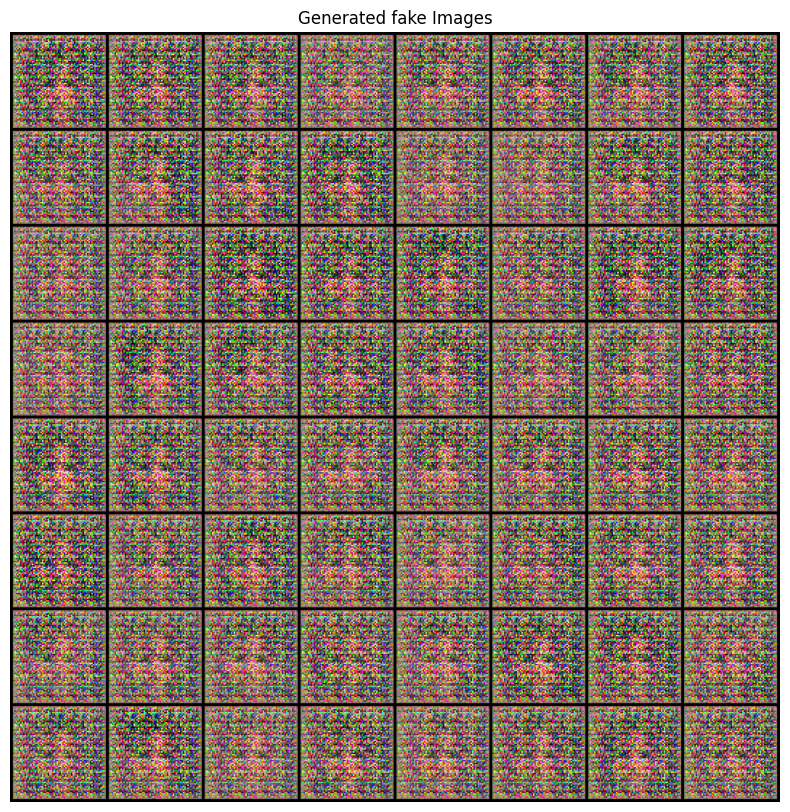

[0/5][100/1583]	Loss_D: 0.5615	Loss_G: 3.2267	D(x): 0.6946	D(G(z)): 0.0575 / 0.0493


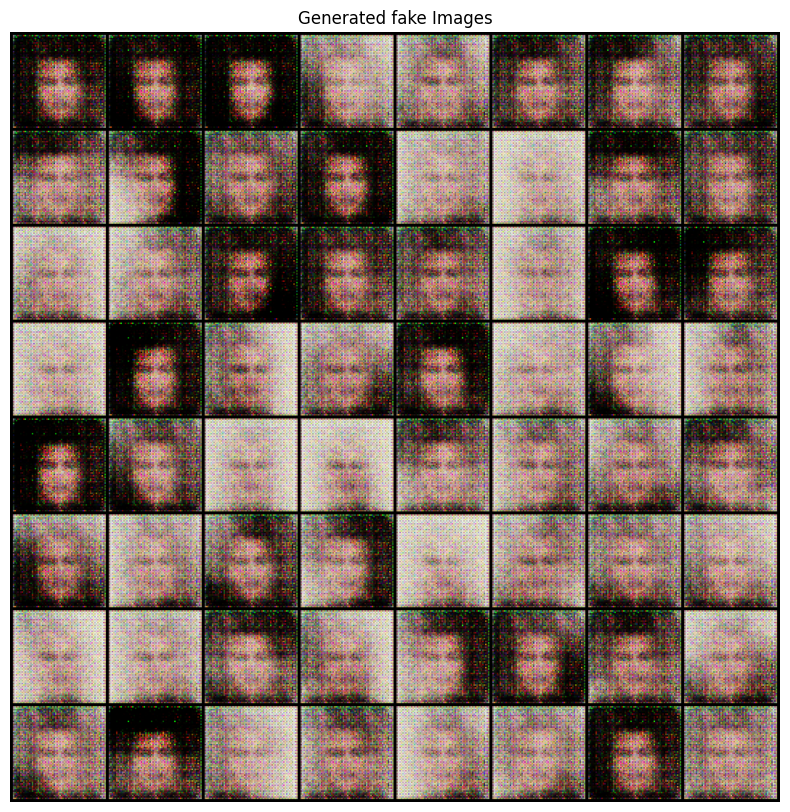

[0/5][150/1583]	Loss_D: 1.0173	Loss_G: 2.4379	D(x): 0.6252	D(G(z)): 0.2770 / 0.1131


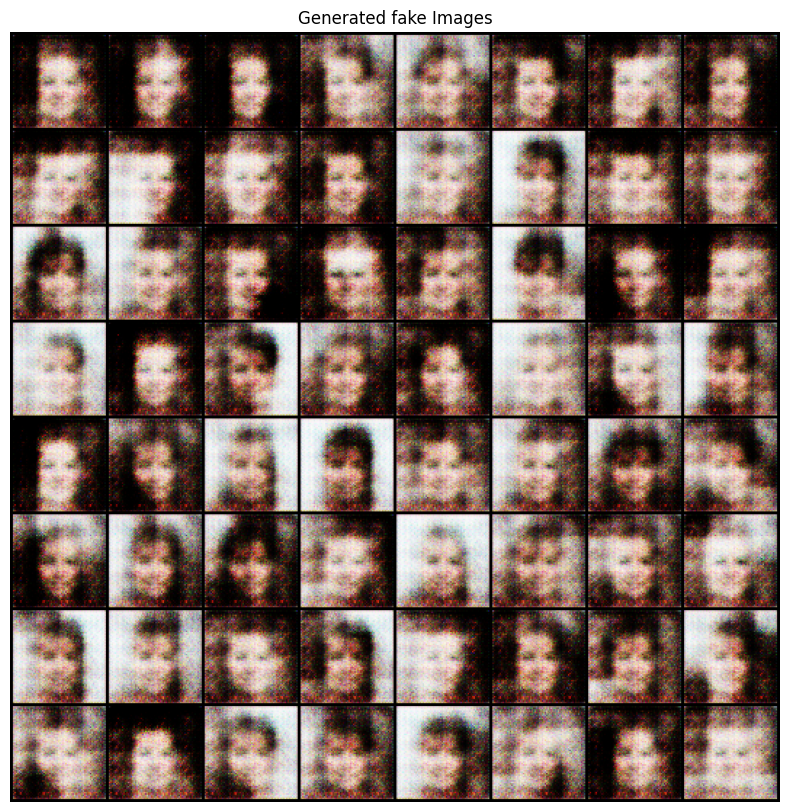

[0/5][200/1583]	Loss_D: 0.9220	Loss_G: 4.2828	D(x): 0.9018	D(G(z)): 0.4743 / 0.0228


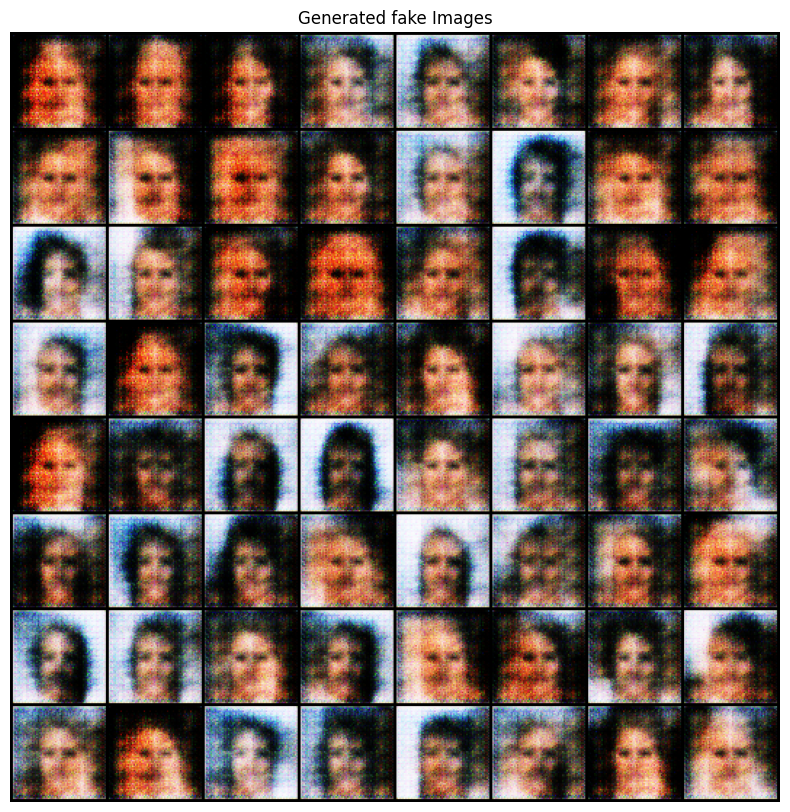

[0/5][250/1583]	Loss_D: 0.6289	Loss_G: 2.2776	D(x): 0.7088	D(G(z)): 0.1956 / 0.1322


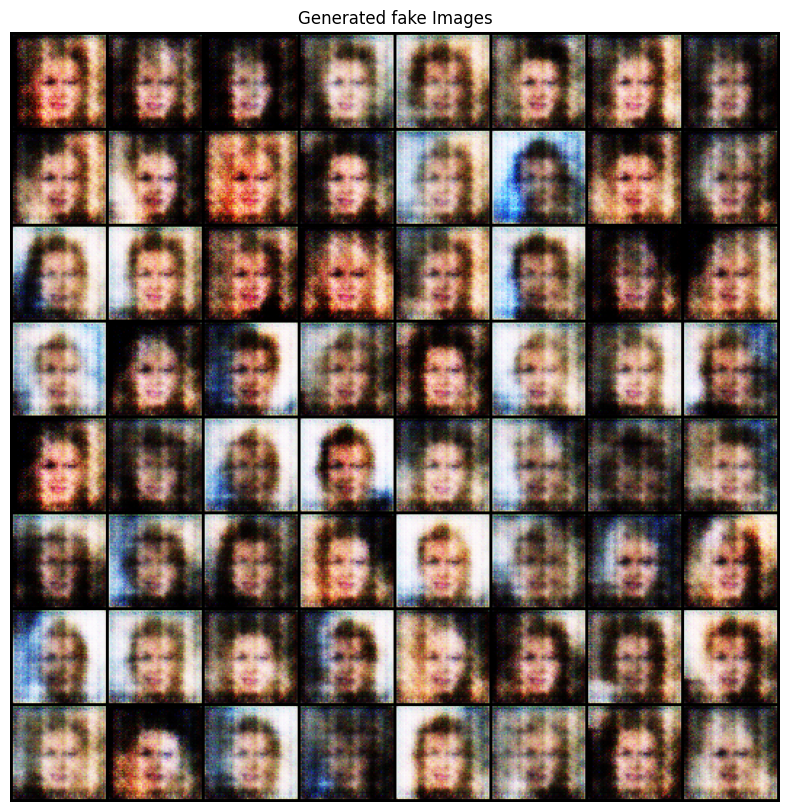

[0/5][300/1583]	Loss_D: 0.3083	Loss_G: 3.2650	D(x): 0.8197	D(G(z)): 0.0752 / 0.0484


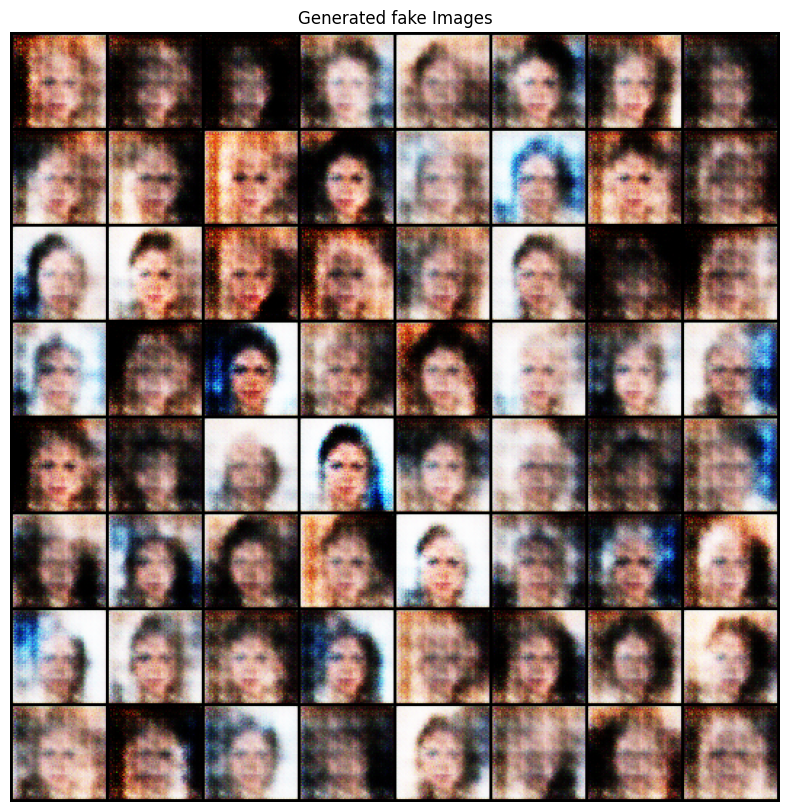

[0/5][350/1583]	Loss_D: 0.7908	Loss_G: 2.3118	D(x): 0.5652	D(G(z)): 0.1019 / 0.1299


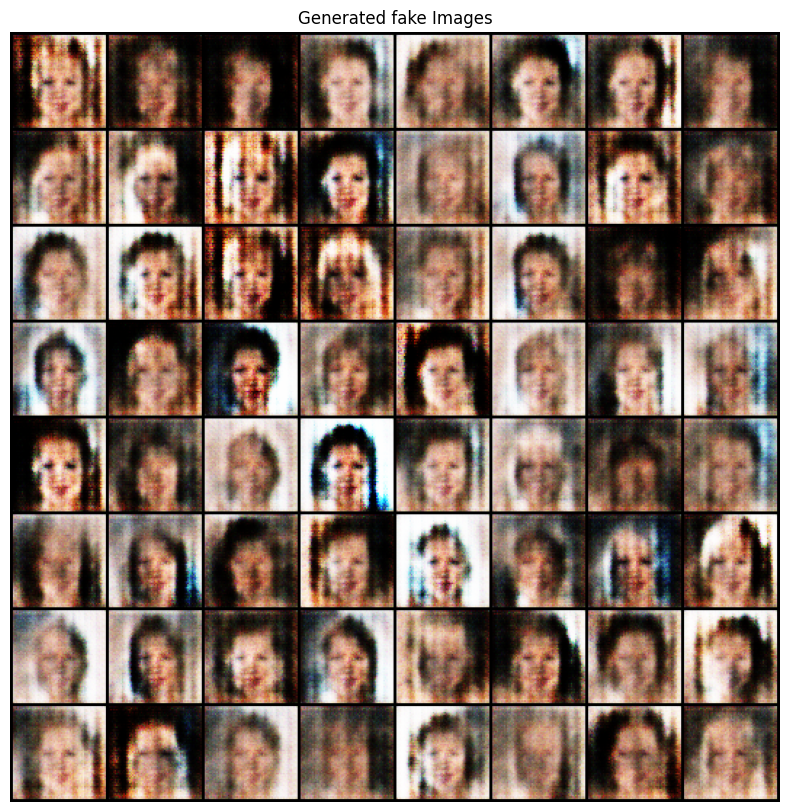

[0/5][400/1583]	Loss_D: 0.7550	Loss_G: 6.7623	D(x): 0.9206	D(G(z)): 0.4521 / 0.0017


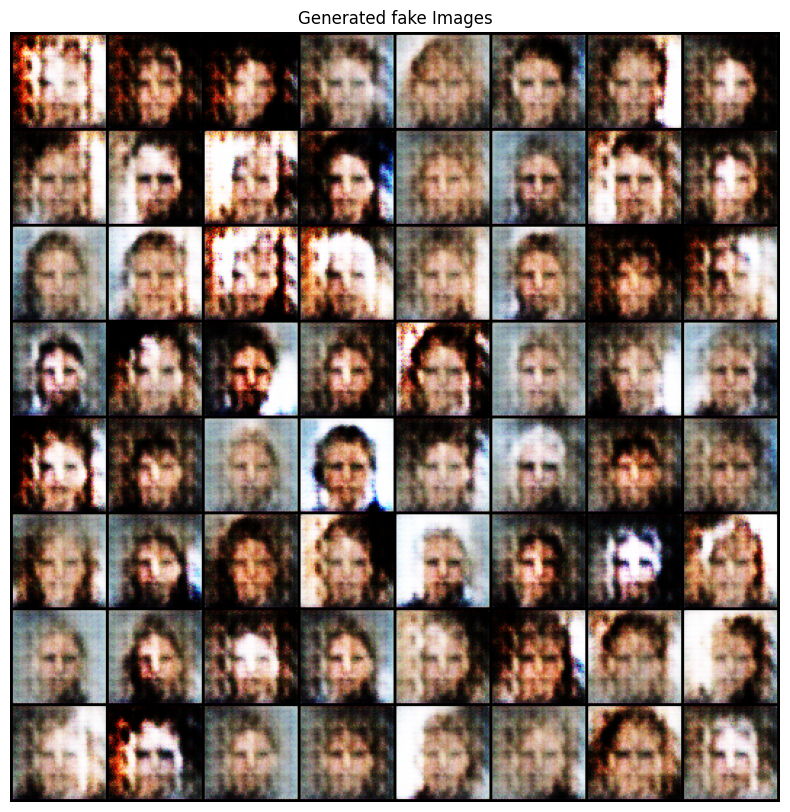

KeyboardInterrupt: 

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

plt.figure(figsize=(10,10))
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(celeba_dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## 1.1 Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), 0, device=device).type(torch.float32)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        label.fill_(real_label)
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## 1.2 Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        label.fill_(fake_label)
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            dsp_str = '[%d/%d][%d/%d]' % (epoch, num_epochs, i, len(celeba_dataloader))
            print('%s\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (dsp_str, errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            # Check how the generator is doing by saving G's output on fixed_noise
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            fake = vutils.make_grid(fake[:64], padding=2, normalize=True)
            plt.axis("off")
            plt.title("Generated fake Images")
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True),(1,2,0)))
            plt.pause(1)


        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        iters += 1

## 2.2 Text-based image generation
Latest technology!

Acknowledgement: https://huggingface.co/CompVis/stable-diffusion-v1-4

### (a) Setup

In [ ]:
! pip install --upgrade diffusers transformers scipy

In [ ]:
import torch
from diffusers import StableDiffusionPipeline
import matplotlib.pyplot as plt

model_id = "CompVis/stable-diffusion-v1-4"
device = "cuda"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to(device)

### (b) Inference

In [ ]:
prompt = "a photo of an astronaut riding a horse on mars"
image = pipe(prompt).images[0]
plt.imshow(image)
plt.show()